In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, recall_score, f1_score
import warnings
warnings.filterwarnings('ignore')


<font size = "13"><span style="color:#EFE1D1">
✍(◔◡◔) EX1: Fit a nonic equation to a quadratic equation
</span></font>

In [24]:
class CFGNonicEquation:
    seed = 99
    n_init = 10
    n_test = 100
    degree = 9

In [25]:
def func(x, n_samples):
  return x**2 + np.random.rand(n_samples)

# mse function with numpy
def mse(y_true, y_pred):
  return np.mean((y_true - y_pred)**2)

def data_init():
  np.random.seed(CFGNonicEquation.seed)
  X = np.linspace(-5, 5, CFGNonicEquation.n_init)
  y = func(X, CFGNonicEquation.n_init)
  X_test = np.linspace(-50, 50, CFGNonicEquation.n_test)
  y_test = func(X_test, CFGNonicEquation.n_test)
  return X, y, X_test, y_test


In [26]:
X, y, X_test, y_test = data_init()

In [27]:
model = make_pipeline(PolynomialFeatures(CFGNonicEquation.degree, include_bias=False), LinearRegression())
model.fit(X.reshape(-1, 1), y)

y_pred = model.predict(X.reshape(-1, 1))

mse_init = mse(y, y_pred)
y_pred_new = model.predict(X_test.reshape(-1, 1))
mse_test = mse(y_test, y_pred_new)

print('MSE (10 điểm): {:.2f}'.format(mse_init))
print('MSE (100 điểm): {:.2f}'.format(mse_test))

MSE (10 điểm): 0.00
MSE (100 điểm): 1942361296527976824832.00


In [28]:
def viz():
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.scatter(X, y, label='Fitted data')
    plt.plot(X, y_pred, label='Fitted line', color='r')
    plt.xlabel('X')
    plt.ylabel('y')
    plt.legend()
    plt.title('MSE (10 điểm): {:.2f}'.format(mse_init))

    plt.subplot(1, 2, 2)
    plt.scatter(X_test, y_test, label='Eval data')
    plt.plot(X_test, y_pred_new, label='Fitted line', color='r')
    plt.xlabel('X')
    plt.ylabel('y')
    plt.legend()
    plt.title('MSE (100 điểm): {:.2f}'.format(mse_test))

    plt.tight_layout()
    plt.show()


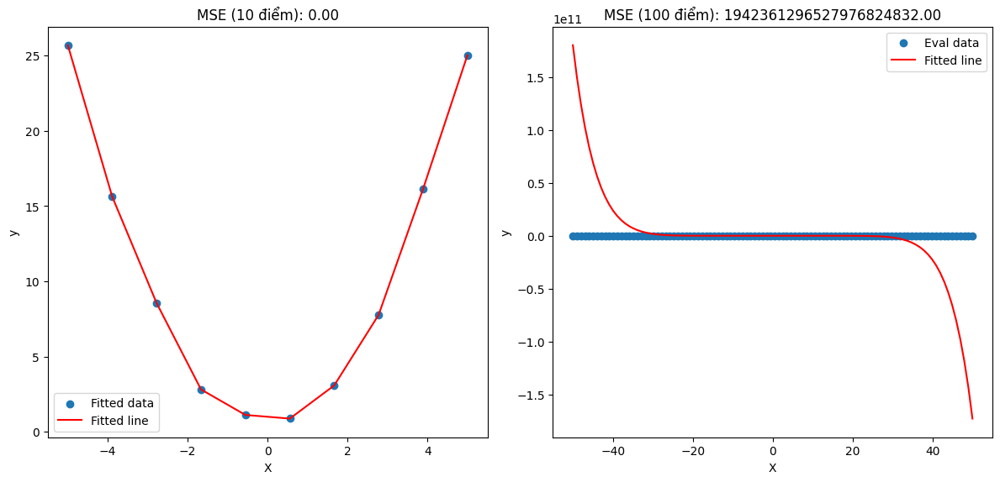

In [29]:
viz()

(っ °Д °;)っ The phenomenon happened here is called overfitting <br>
1. Fitting a polynomial equation of degree 9 to a quadratic equation is overkill.<br>
- MSE = 0 when fitting with the first 10 data points<br>
- MSE = very large when adding 100 test data points<br>


# Tuần này em không có thời gian tự implement tất cả nên dùng chatGPT khá nhiều, code thì em vẫn đọc hiểu anh nhé
# Sorry anh

# Bai 2: (tham khao ChatGPT)

In [30]:
def convolution(X, W, stride, padding):
    batch_size, in_channels, in_height, in_width = X.shape
    out_channels, _, kernel_height, kernel_width = W.shape

    out_height = (in_height + 2 * padding - kernel_height) // stride + 1
    out_width = (in_width + 2 * padding - kernel_width) // stride + 1

    if padding > 0:
        X_padded = np.pad(X, ((0, 0), (0, 0), (padding, padding),
                          (padding, padding)), mode='constant')
    else:
        X_padded = X

    Y = np.zeros((batch_size, out_channels, out_height, out_width))

    for b in range(batch_size):
        for c in range(out_channels):
            for i in range(0, in_height + 2 * padding - kernel_height + 1, stride):
                for j in range(0, in_width + 2 * padding - kernel_width + 1, stride):
                    X_slice = X_padded[b, :, i:i +
                                       kernel_height, j:j+kernel_width]
                    Y[b, c, i//stride, j//stride] = np.sum(X_slice * W[c])

    return Y


In [31]:
X = np.array([[[[1, 2, 3], [4, 5, 6], [7, 8, 9]]]])  
W = np.array([[[[1, 0], [0, -1]]]])  
stride = 1
padding = 0

result = convolution(X, W, stride, padding)
print("Convolution from scratch:")
print(result)

# Kiểm tra với PyTorch

X_torch = torch.tensor(X, dtype=torch.float32)
W_torch = torch.tensor(W, dtype=torch.float32)

result_torch = F.conv2d(X_torch, W_torch, stride=stride, padding=padding)
print("Convolution using PyTorch:")
print(result_torch.numpy())

Convolution from scratch:
[[[[-4. -4.]
   [-4. -4.]]]]
Convolution using PyTorch:
[[[[-4. -4.]
   [-4. -4.]]]]


# Bai 3: Implement phần lớn VGG simplified nhưng vẫn tham khao chatGPT

In [32]:
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(32, padding=4),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

batch_size = 64

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)


Files already downloaded and verified
Files already downloaded and verified


In [33]:
class VGG(nn.Module):
    def __init__(self):
        super(VGG, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        self.classifier = nn.Sequential(
            nn.Linear(128 * 4 * 4, 256),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(256, 10)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

Epoch 1, Loss: nan
Epoch 2, Loss: nan
Epoch 3, Loss: nan
Epoch 4, Loss: nan
Epoch 5, Loss: nan
Epoch 6, Loss: nan
Epoch 7, Loss: nan
Epoch 8, Loss: nan
Epoch 9, Loss: nan
Epoch 10, Loss: nan
Accuracy: 0.1
Recall: 0.1
F1-Score: 0.01818181818181818


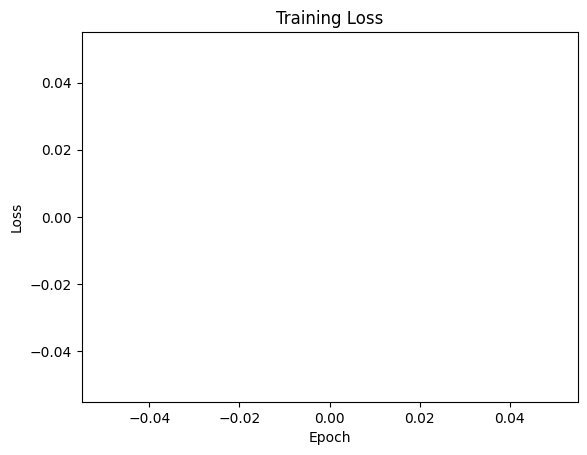

Epoch 1, Loss: 2.3037736482937317
Epoch 2, Loss: 2.30277289880816
Epoch 3, Loss: 2.3016282070018446
Epoch 4, Loss: 2.3006882441928016
Epoch 5, Loss: 2.2996170569563765
Epoch 6, Loss: 2.2984504306407842
Epoch 7, Loss: 2.297559402482894
Epoch 8, Loss: 2.2963974277686585
Epoch 9, Loss: 2.295350818377931
Epoch 10, Loss: 2.29412410417786
Accuracy: 0.1
Recall: 0.1
F1-Score: 0.018562181464188185


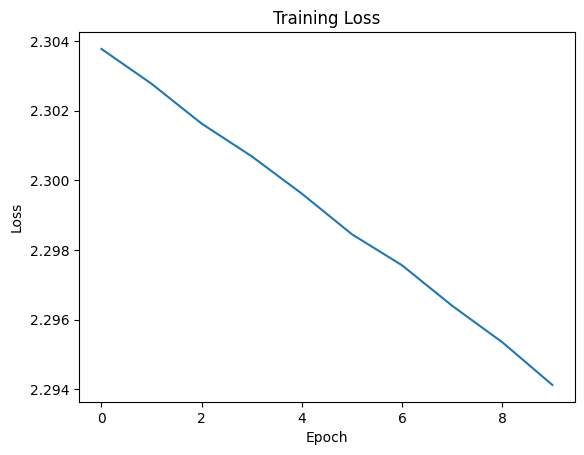

Epoch 1, Loss: 1.7711013457964144
Epoch 2, Loss: 1.3865340815480713
Epoch 3, Loss: 1.1769699206590043
Epoch 4, Loss: 1.04827692220583
Epoch 5, Loss: 0.9642911136455243
Epoch 6, Loss: 0.9126228402795085
Epoch 7, Loss: 0.8662335987743515
Epoch 8, Loss: 0.8193804330152014
Epoch 9, Loss: 0.7942450783213081
Epoch 10, Loss: 0.7592005904601968
Accuracy: 0.7542
Recall: 0.7541999999999999
F1-Score: 0.7551781332544076


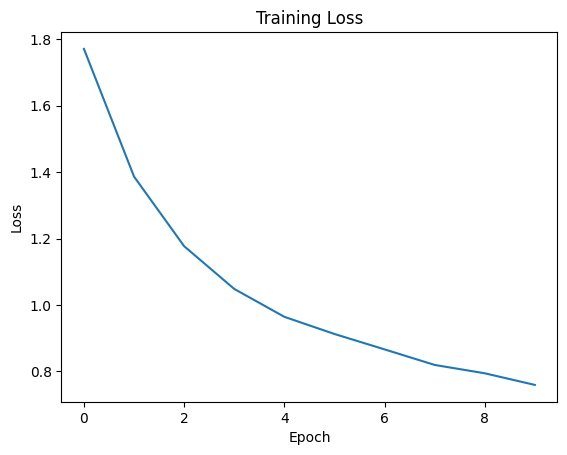

In [37]:
def visualize():
    plt.plot(train_losses)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

# Evaluation on the test set
def eval():
    net.eval()
    all_preds = []
    true_labels = []

    with torch.no_grad():
        for data in testloader:
            inputs, labels = data
            outputs = net(inputs)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    accuracy = accuracy_score(true_labels, all_preds)
    recall = recall_score(true_labels, all_preds, average='macro')
    f1 = f1_score(true_labels, all_preds, average='macro')

    print(f"Accuracy: {accuracy}")
    print(f"Recall: {recall}")
    print(f"F1-Score: {f1}")

    
learning_rates = [1, 0.00001, 0.01]

for lr in learning_rates:
    net = VGG()

    # Choose loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(net.parameters(), lr=lr, momentum=0.9)

    # Training loop
    num_epochs = 10

    train_losses = []

    for epoch in range(num_epochs):
        running_loss = 0.0
        for i, data in enumerate(trainloader, 0):
            inputs, labels = data
            optimizer.zero_grad()
            outputs = net(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        train_losses.append(running_loss / len(trainloader))
        print(f"Epoch {epoch+1}, Loss: {running_loss / len(trainloader)}")
    eval()
    visualize()

# Bai 4
## Có hai lý do chính khiến width và height giảm nhưng depth lại tăng khi build model:

1. ### Convolutional layer: Convolutional layer là một layer trong CNN sử dụng kernel để trích xuất các đặc trưng từ input. Kernel có kích thước cố định, vì vậy khi kernel di chuyển trên input, width và height của output sẽ giảm. Depth của output lại tăng, vì mỗi kernel sẽ tạo ra một map feature riêng.

2. ### Pooling layer: Pooling layer là một layer trong CNN sử dụng phương pháp pooling để giảm kích thước output của convolutional layer. Phương pháp pooling thường sử dụng là max pooling, trong đó chỉ lấy giá trị lớn nhất trong một vùng nhỏ của output để làm giá trị của output. Vì vậy, width và height của output sẽ giảm. Depth của output không đổi.

# Bai 5